In [2]:
import pandas as pd
from tabulate import tabulate

df_check = pd.read_csv('prices_round_3_day_2.csv', delimiter=';')

print(tabulate(df_check, headers='keys'))

          day    timestamp  product                        bid_price_1    bid_volume_1    bid_price_2    bid_volume_2    bid_price_3    bid_volume_3    ask_price_1    ask_volume_1    ask_price_2    ask_volume_2    ask_price_3    ask_volume_3    mid_price    profit_and_loss
------  -----  -----------  ---------------------------  -------------  --------------  -------------  --------------  -------------  --------------  -------------  --------------  -------------  --------------  -------------  --------------  -----------  -----------------
     0      2            0  PICNIC_BASKET2                       30094              11          30093              27            nan             nan          30099               1          30100              37            nan             nan      30096.5                  0
     1      2            0  VOLCANIC_ROCK_VOUCHER_9750             469              11            nan             nan            nan             nan            470              1

In [3]:
import matplotlib.pyplot as plt

df = {}
products =['VOLCANIC_ROCK', 'VOLCANIC_ROCK_VOUCHER_9500','VOLCANIC_ROCK_VOUCHER_9750','VOLCANIC_ROCK_VOUCHER_10000','VOLCANIC_ROCK_VOUCHER_10250','VOLCANIC_ROCK_VOUCHER_10500']

for prod in products:
    df[prod] = df_check[df_check['product'] == prod]

df_rock = df['VOLCANIC_ROCK']
df_v95 = df['VOLCANIC_ROCK_VOUCHER_9500']
df_v97 = df['VOLCANIC_ROCK_VOUCHER_9750']
df_v100 = df['VOLCANIC_ROCK_VOUCHER_10000']
df_v102 = df['VOLCANIC_ROCK_VOUCHER_10250']
df_v105 = df['VOLCANIC_ROCK_VOUCHER_10500']

In [4]:
# Compute all the weighted mid prices

import numpy as np
import math

bid_price_1 = {}
bid_volume_1 = {}
bid_price_2 = {}
bid_volume_2 = {}
bid_price_3 = {}
bid_volume_3 = {}
ask_price_1 = {}
ask_volume_1 = {}
ask_price_2 = {}
ask_volume_2 = {}
ask_price_3 = {}
ask_volume_3 = {}

products =['VOLCANIC_ROCK', 'VOLCANIC_ROCK_VOUCHER_9500','VOLCANIC_ROCK_VOUCHER_9750','VOLCANIC_ROCK_VOUCHER_10000','VOLCANIC_ROCK_VOUCHER_10250','VOLCANIC_ROCK_VOUCHER_10500']

for prod in products:
    bid_price_1[prod] = list(df[prod]['bid_price_1'])
    bid_volume_1[prod] = list(df[prod]['bid_volume_1'])
    bid_price_2[prod] = list(df[prod]['bid_price_2'])
    bid_volume_2[prod] = list(df[prod]['bid_volume_2'])
    bid_price_3[prod] = list(df[prod]['bid_price_3'])
    bid_volume_3[prod] = list(df[prod]['bid_volume_3'])

    ask_price_1[prod] = list(df[prod]['ask_price_1'])
    ask_volume_1[prod] = list(df[prod]['ask_volume_1'])
    ask_price_2[prod] = list(df[prod]['ask_price_2'])
    ask_volume_2[prod] = list(df[prod]['ask_volume_2'])
    ask_price_3[prod] = list(df[prod]['ask_price_3'])
    ask_volume_3[prod] = list(df[prod]['ask_volume_3'])

mid_weight = {}

for prod in products:
    mid_weight[prod] = []

    for i in range(len(bid_price_1[prod])):
        total_weight = 0
        mid_weight_curr = 0
        if not math.isnan(bid_price_1[prod][i]):
            mid_weight_curr += bid_price_1[prod][i] * bid_volume_1[prod][i]
            total_weight += bid_volume_1[prod][i]
    
        if not math.isnan(bid_price_2[prod][i]):
            mid_weight_curr += bid_price_2[prod][i] * bid_volume_2[prod][i]
            total_weight += bid_volume_2[prod][i]
    
        if not math.isnan(bid_price_3[prod][i]):
            mid_weight_curr += bid_price_3[prod][i] * bid_volume_3[prod][i]
            total_weight += bid_volume_3[prod][i]

        if not math.isnan(ask_price_1[prod][i]):
            mid_weight_curr += ask_price_1[prod][i] * ask_volume_1[prod][i]
            total_weight += ask_volume_1[prod][i]
    
        if not math.isnan(ask_price_2[prod][i]):
            mid_weight_curr += ask_price_2[prod][i] * ask_volume_2[prod][i]
            total_weight += ask_volume_2[prod][i]
    
        if not math.isnan(ask_price_3[prod][i]):
            mid_weight_curr += ask_price_3[prod][i] * ask_volume_3[prod][i]
            total_weight += ask_volume_3[prod][i]

        mid_weight[prod].append(mid_weight_curr / total_weight if total_weight != 0 else 0)
    


C:\Users\amino\AppData\Local\Temp\ipykernel_28668\3960751758.py:13: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


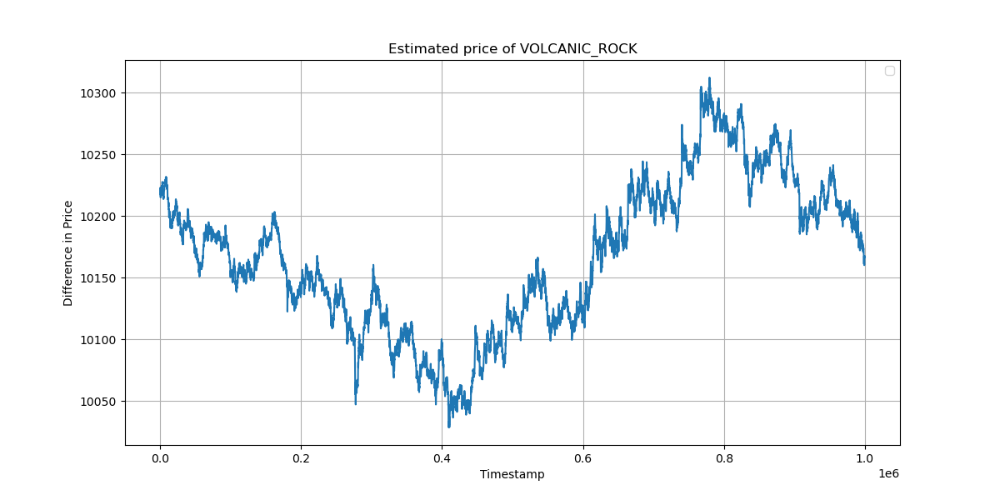

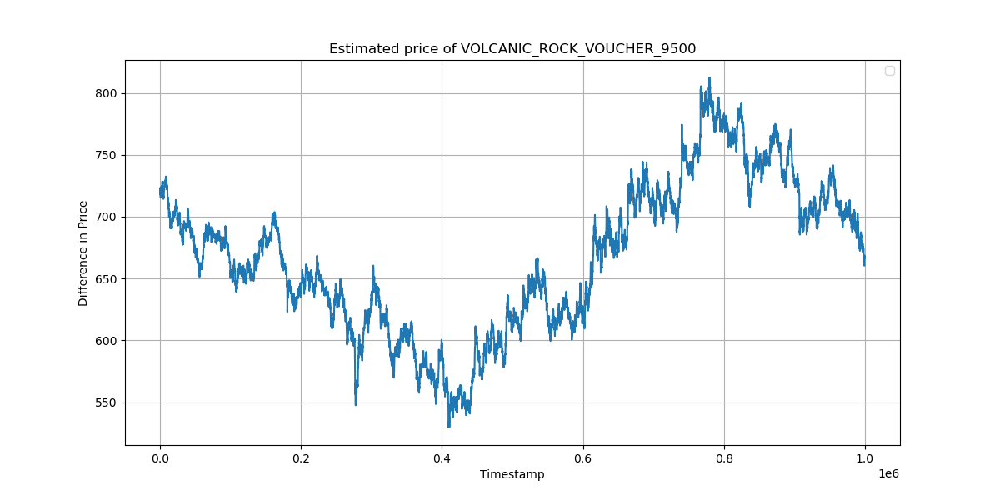

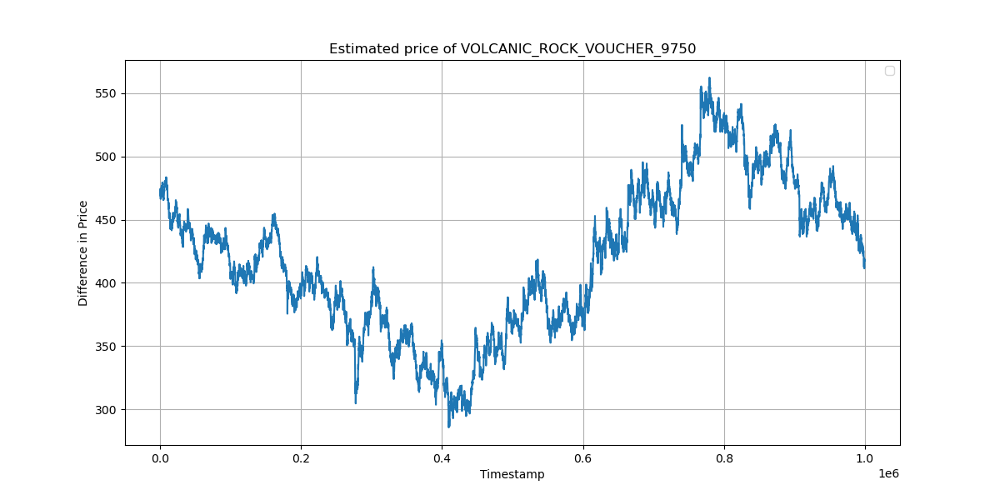

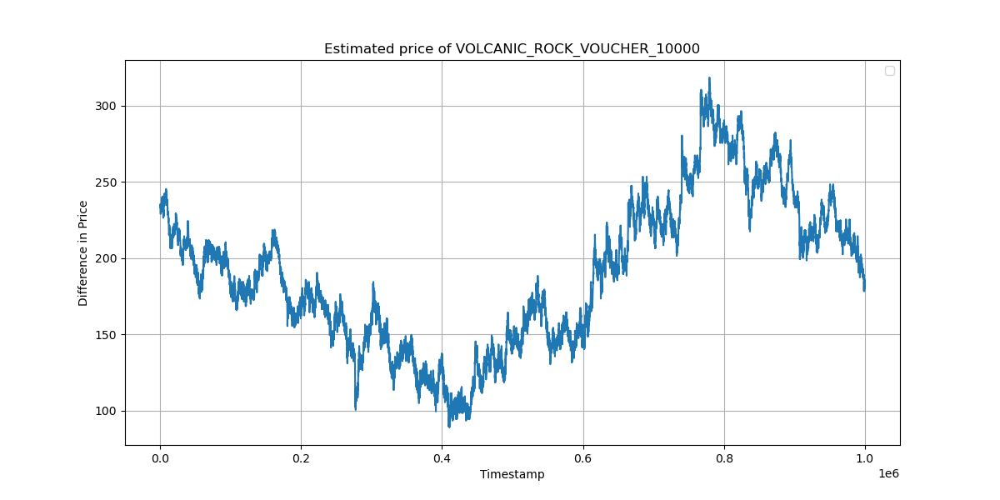

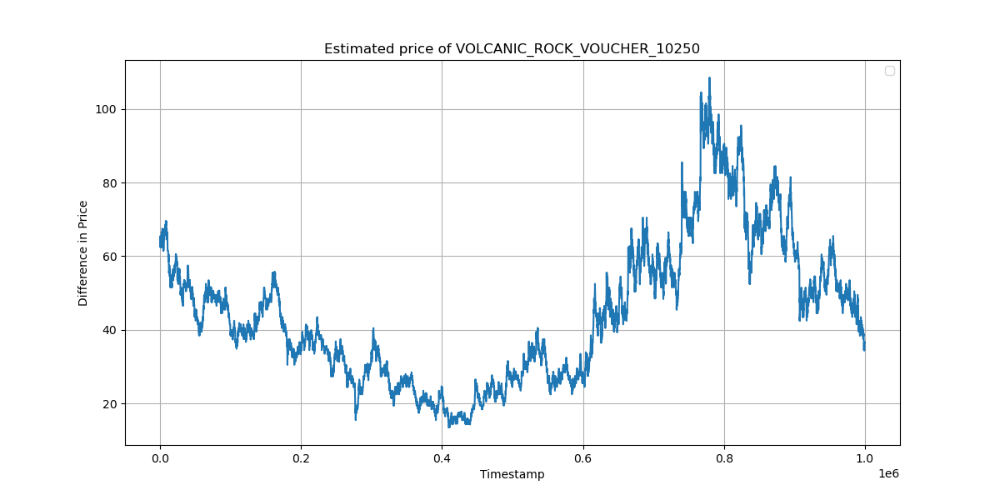

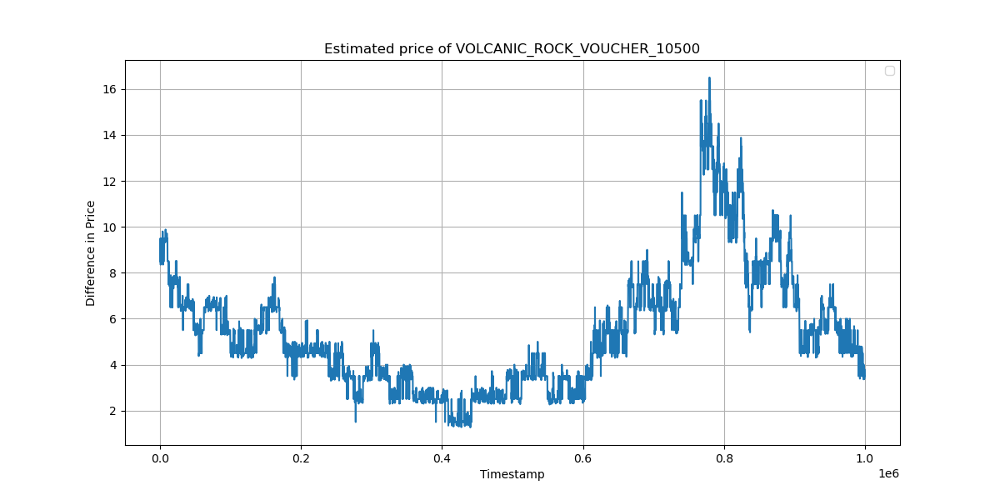

In [5]:
%matplotlib ipympl
import matplotlib.pyplot as plt

time = list(df_rock['timestamp'])


for prod in products:
    plt.figure(figsize=(12, 6))
    plt.plot(time, mid_weight[prod])
    plt.xlabel('Timestamp')
    plt.ylabel('Difference in Price')
    plt.title('Estimated price of ' + prod)
    plt.legend()
    plt.grid(True)
    #plt.xlim([800000,1000000])
    plt.show()

In [6]:
%matplotlib ipympl
import numpy as np
import math
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

time_lst = list(df_rock['timestamp'])

products =['VOLCANIC_ROCK', 'VOLCANIC_ROCK_VOUCHER_9500','VOLCANIC_ROCK_VOUCHER_9750','VOLCANIC_ROCK_VOUCHER_10000','VOLCANIC_ROCK_VOUCHER_10250','VOLCANIC_ROCK_VOUCHER_10500']
rock_mprice = mid_weight['VOLCANIC_ROCK']

intercepts = {}
coeffs = {}

for prod in products[1:]:
    # Linear Regression model
    model = LinearRegression()

    Vars = []
    y = []
    time = []

    for i in range(len(rock_mprice)):
        Vars.append([mid_weight[prod][i]])
        y.append(rock_mprice[i])
        time.append(time_lst[i])

    X = np.array(Vars)

    # Fitting the model
    model.fit(X, y)

    # Prediction
    y_pred = model.predict(X)

    intercepts[prod] = model.intercept_
    coeffs[prod] = model.coef_[0]

    # Coefficients and intercept
    #print(prod + " Intercept:", intercepts[prod])
    print(prod + " Coefficient:", coeffs[prod])

    

    #print(prod + " root of MSE: ",math.sqrt(mean_squared_error(y, y_pred)))

VOLCANIC_ROCK_VOUCHER_9500 Coefficient: 1.0023352455712518
VOLCANIC_ROCK_VOUCHER_9750 Coefficient: 1.0220965737395178
VOLCANIC_ROCK_VOUCHER_10000 Coefficient: 1.2408514001276931
VOLCANIC_ROCK_VOUCHER_10250 Coefficient: 3.0875855115499706
VOLCANIC_ROCK_VOUCHER_10500 Coefficient: 21.19322864797994


C:\Users\amino\AppData\Local\Temp\ipykernel_28668\1226830117.py:11: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


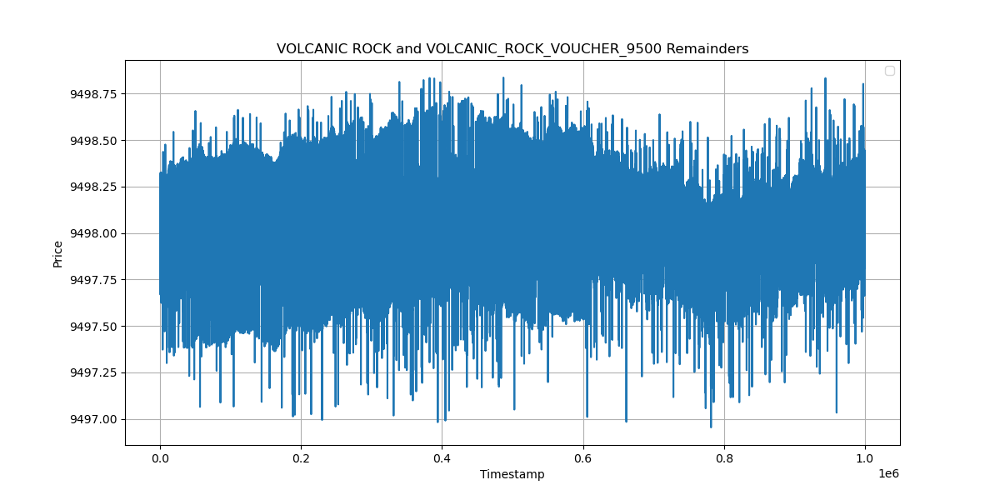

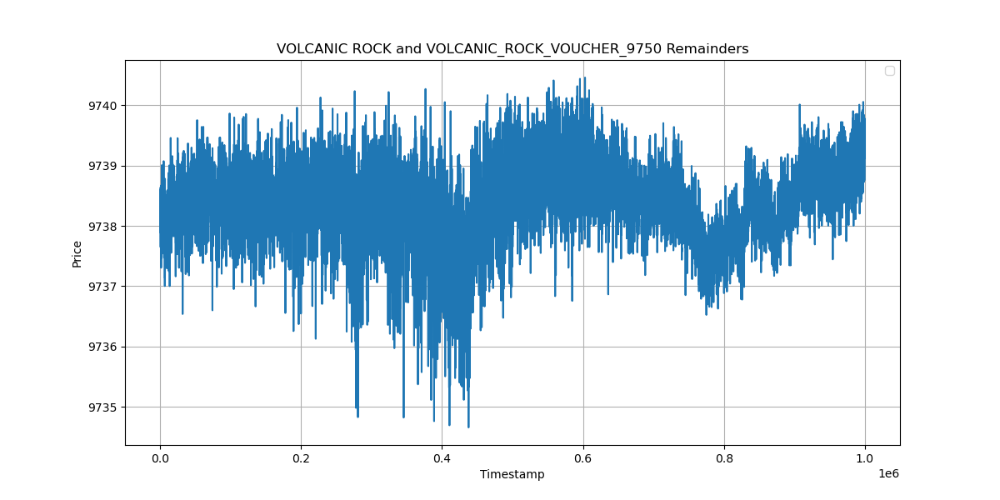

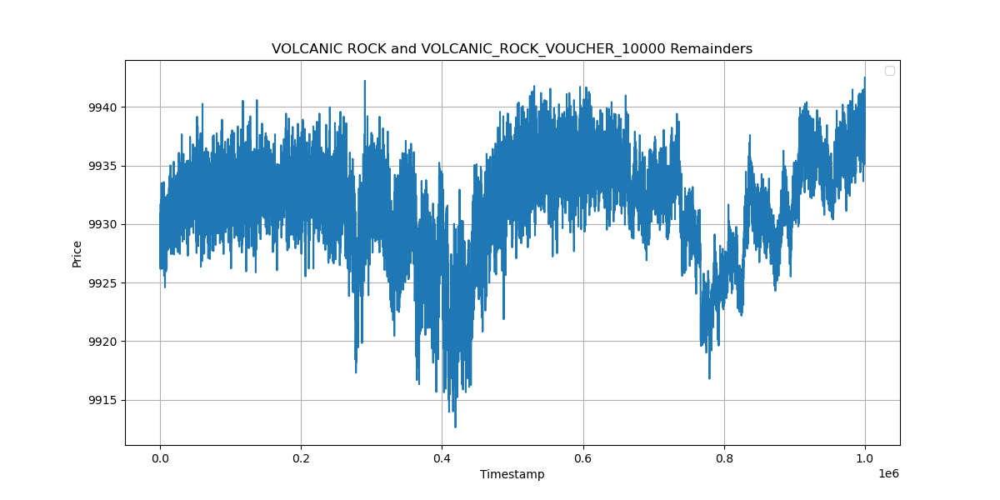

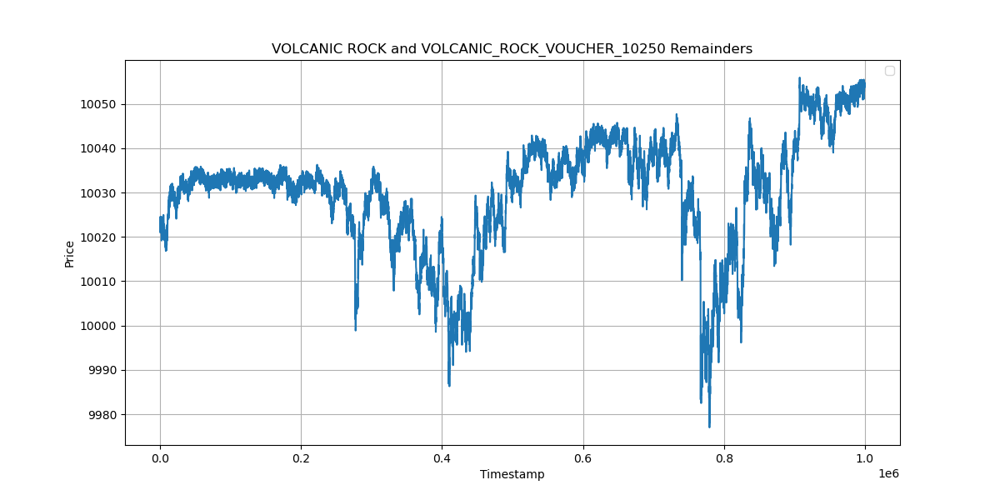

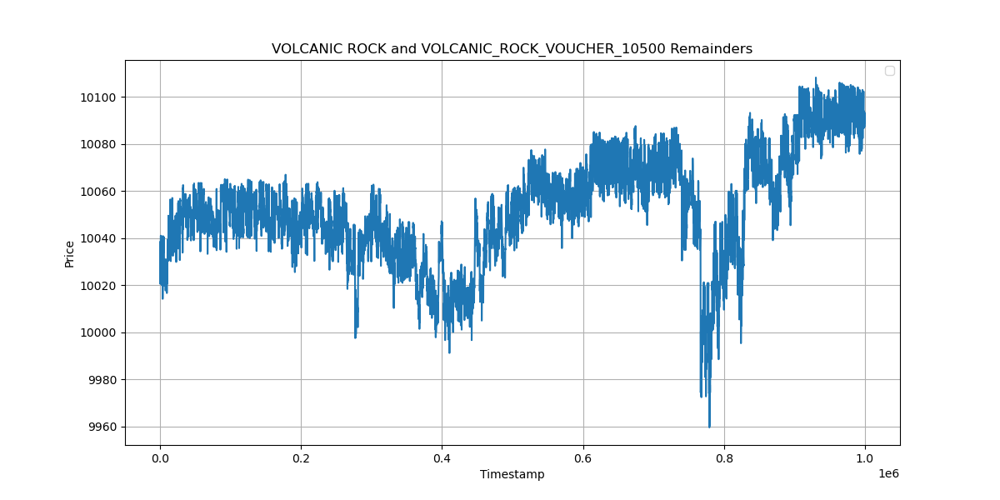

In [7]:
rock_voucher_diff = {}

for prod in products[1:]:
    rock_voucher_diff[prod] = [(rock_mprice[i] - coeffs[prod] * mid_weight[prod][i]) for i in range(len(rock_mprice))]

    plt.figure(figsize=(12, 6))
    plt.plot(df_rock['timestamp'],rock_voucher_diff[prod])
    plt.xlabel('Timestamp')
    plt.ylabel('Price')
    plt.title('VOLCANIC ROCK and ' + prod + ' Remainders')
    plt.legend()
    plt.grid(True)
    plt.show()


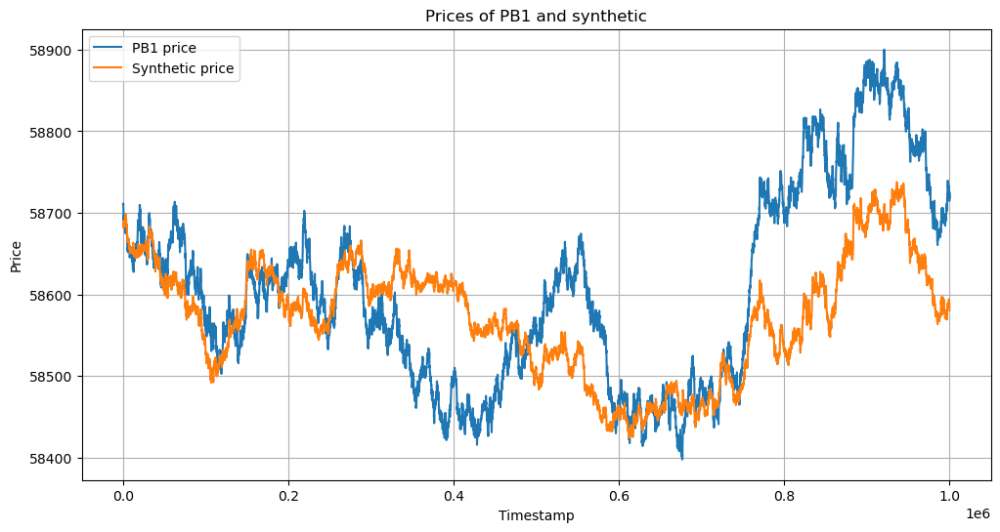

C:\Users\amino\AppData\Local\Temp\ipykernel_14132\2695470371.py:31: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


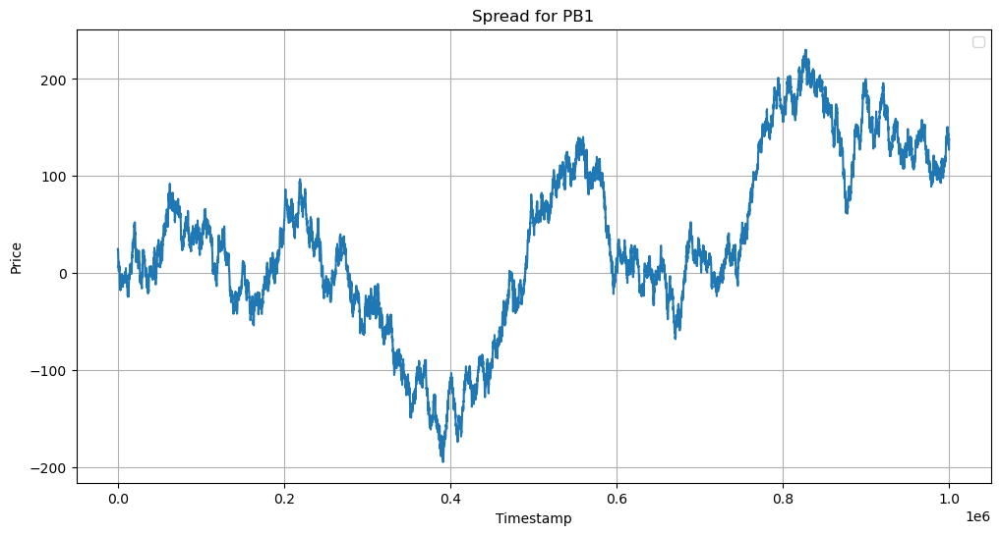

In [5]:
time_lst = list(df_cro['timestamp'])
cro_price = mid_weight['cro']
jam_price = mid_weight['jam']
djem_price = mid_weight['djem']
pb1_price = mid_weight['pb1']
pb2_price = mid_weight['pb2']

basket1_synt = [6 * cro_price[i] + 3 * jam_price[i] + djem_price[i] for i in range(len(time_lst))]
#basket_average = [(basket_synt[i] + pb1_price[i])/2 for i in range(len(time_lst))]
basket1_diff = [pb1_price[i] - basket1_synt[i] for i in range(len(time_lst))]

plt.figure(figsize=(12, 6))
plt.plot(time_lst, pb1_price, label = 'PB1 price')
plt.plot(time_lst, basket1_synt, label = 'Synthetic price')
#plt.plot(time_lst, basket_average)
plt.xlabel('Timestamp')
plt.ylabel('Price')
plt.title('Prices of PB1 and synthetic')
plt.legend()
plt.grid(True)
#plt.xlim([0,200000])
#plt.ylim([-50,200])
plt.show()

plt.figure(figsize=(12, 6))
plt.plot(time_lst, basket1_diff)
#plt.plot(time_lst, basket_average)
plt.xlabel('Timestamp')
plt.ylabel('Price')
plt.title('Spread for PB1')
plt.legend()
plt.grid(True)
#plt.xlim([0,200000])
#plt.ylim([-50,200])
plt.show()

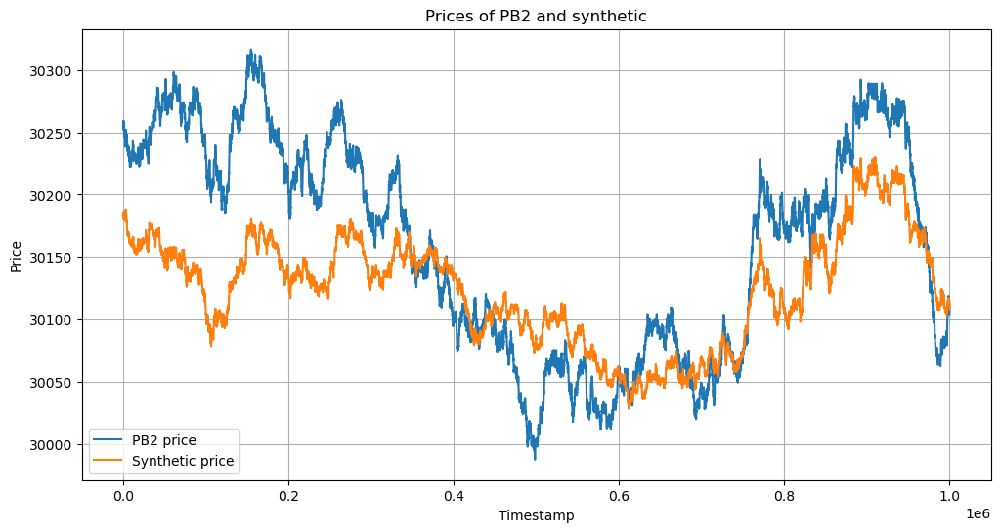

C:\Users\amino\AppData\Local\Temp\ipykernel_1608\1027703811.py:24: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


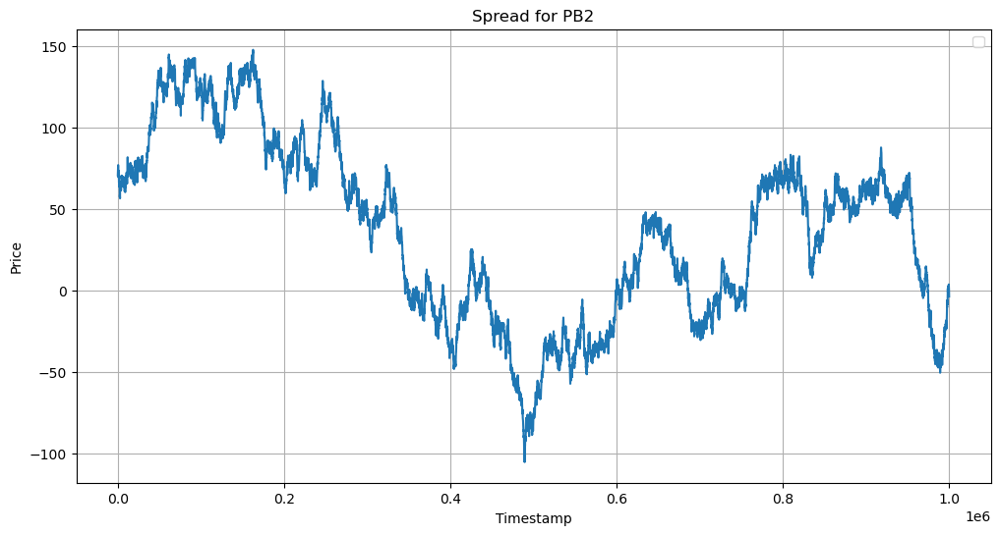

In [9]:
basket2_synt = [4 * cro_price[i] + 2 * jam_price[i] for i in range(len(time_lst))]
#basket_average = [(basket_synt[i] + pb1_price[i])/2 for i in range(len(time_lst))]
basket2_diff = [pb2_price[i] - basket2_synt[i] for i in range(len(time_lst))]

plt.figure(figsize=(12, 6))
plt.plot(time_lst, pb2_price, label = 'PB2 price')
plt.plot(time_lst, basket2_synt, label = 'Synthetic price')
#plt.plot(time_lst, basket_average)
plt.xlabel('Timestamp')
plt.ylabel('Price')
plt.title('Prices of PB2 and synthetic')
plt.legend()
plt.grid(True)
#plt.xlim([0,200000])
#plt.ylim([-50,200])
plt.show()

plt.figure(figsize=(12, 6))
plt.plot(time_lst, basket2_diff)
#plt.plot(time_lst, basket_average)
plt.xlabel('Timestamp')
plt.ylabel('Price')
plt.title('Spread for PB2')
plt.legend()
plt.grid(True)
#plt.xlim([0,200000])
#plt.ylim([-50,200])
plt.show()

PB1 Intercept: 21097.403030417845
PB1 Coefficients Cro, Jam, Djem: [10.98386474 -0.63642212 -0.39078933]
PB1 root of MSE:  64.8485263850948


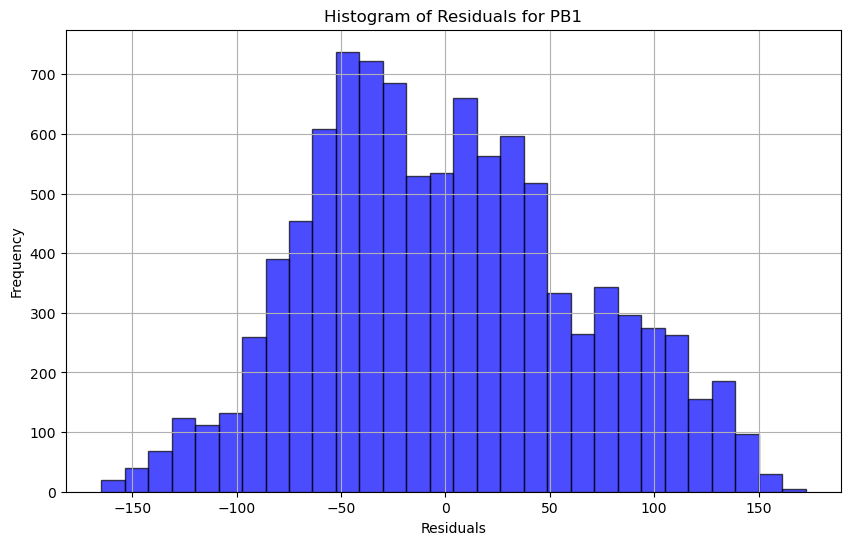

In [5]:
import numpy as np
import math
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

time_lst = list(df_cro['timestamp'])
cro_price = mid_weight['cro']
jam_price = mid_weight['jam']
djem_price = mid_weight['djem']
pb1_price = mid_weight['pb1']
pb2_price = mid_weight['pb2']

# Linear Regression model
model = LinearRegression()

Vars = []
y = []
time = []

for i in range(len(cro_price)):
    Vars.append([cro_price[i],jam_price[i],djem_price[i]])
    y.append(pb1_price[i])
    time.append(time_lst[i])

X = np.array(Vars)

# Fitting the model
model.fit(X, y)

# Prediction
y_pred = model.predict(X)
#print("Predictions:", y_pred)

# Coefficients and intercept
print("PB1 Intercept:", model.intercept_)
print("PB1 Coefficients Cro, Jam, Djem:", model.coef_)

print("PB1 root of MSE: ", math.sqrt(mean_squared_error(y, y_pred)))

# Calculate residuals
residuals = [y[i] - y_pred[i] for i in range(len(y))]

# Create a histogram for residuals
plt.figure(figsize=(10, 6))
plt.hist(residuals, bins=30, color='blue', edgecolor='black', alpha=0.7)
plt.xlabel('Residuals')
plt.ylabel('Frequency')
plt.title('Histogram of Residuals for PB1')
plt.grid(True)
plt.show()


PB2 Intercept: -5167.784030915704
PB2 Coefficients Cro, Jam, Djem: [ 7.22257409  2.48206568 -0.87389777]
PB2 root of MSE:  44.54804410961108


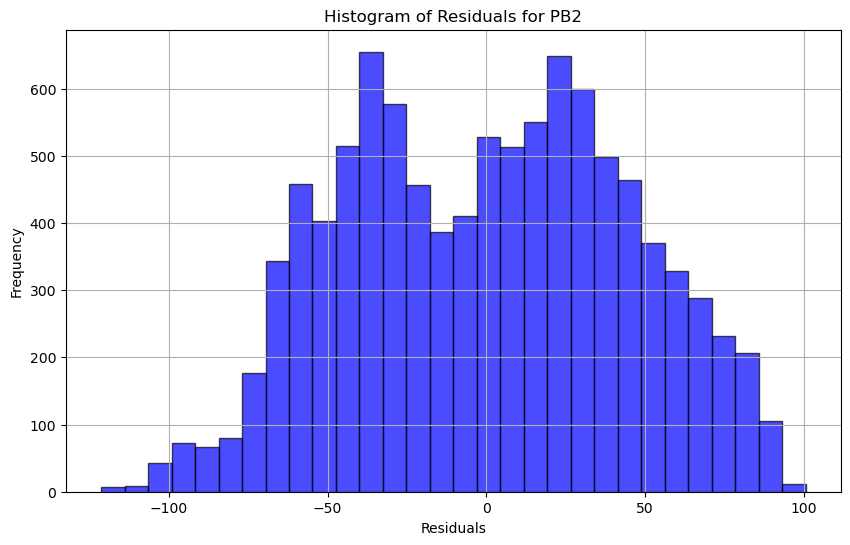

In [6]:
Vars = []
y = []
time = []

for i in range(len(cro_price)):
    Vars.append([cro_price[i],jam_price[i],djem_price[i]])
    y.append(pb2_price[i])
    time.append(time_lst[i])

X = np.array(Vars)

# Fitting the model
model.fit(X, y)

# Prediction
y_pred = model.predict(X)
#print("Predictions:", y_pred)

# Coefficients and intercept
print("PB2 Intercept:", model.intercept_)
print("PB2 Coefficients Cro, Jam, Djem:", model.coef_)

print("PB2 root of MSE: ",math.sqrt(mean_squared_error(y, y_pred)))

# Calculate residuals
residuals = [y[i] - y_pred[i] for i in range(len(y))]

# Create a histogram for residuals
plt.figure(figsize=(10, 6))
plt.hist(residuals, bins=30, color='blue', edgecolor='black', alpha=0.7)
plt.xlabel('Residuals')
plt.ylabel('Frequency')
plt.title('Histogram of Residuals for PB2')
plt.grid(True)
plt.show()


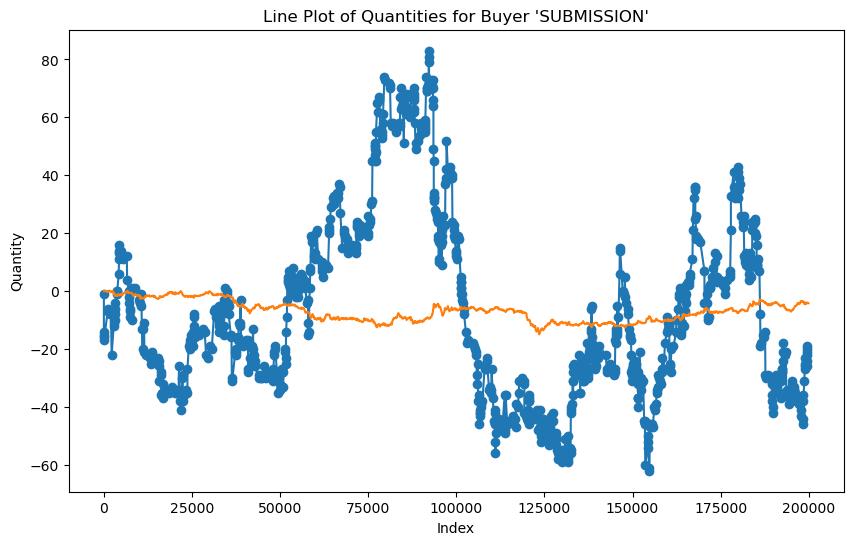

In [54]:
import json
import matplotlib.pyplot as plt

filename = "Log_kelp_ga.log"
json_str = ""
found = False

with open(filename, "r") as f:
    # Read lines until we find the marker "Trade History:"
    for line in f:
        if "Trade History:" in line:
            # If the same line contains the opening bracket, use it
            if "[" in line:
                json_str = line[line.find("["):]
            else:
                # Otherwise, assume the next line starts the JSON array
                json_str = next(f)
            found = True
            break

    if not found:
        raise ValueError("Could not find 'Trade History:' with '[' in file.")

    # Append the remainder of the file to the JSON string
    json_str += f.read()

# Parse the JSON string into a list of trade objects
data = json.loads(json_str)

# Calculate the total quantity and total money paid for buyer "SUBMISSION"
quantities = []
time_lst = []
quantity = 0
for item in data:
    if item.get("buyer") == "SUBMISSION":
        quantity += item.get("quantity", 0)
        quantities.append(quantity)
        timestamp = item.get("timestamp", 0)
        time_lst.append(timestamp)
    elif item.get("seller") == "SUBMISSION":
        quantity -= item.get("quantity", 0)
        quantities.append(quantity)
        timestamp = item.get("timestamp", 0)
        time_lst.append(timestamp)

# Plot the quantities as a line plot
plt.figure(figsize=(10, 6))
plt.plot(time_lst, quantities, marker='o', linestyle='-')
plt.plot(df_kelp['timestamp'], df_kelp['profit_and_loss'])
plt.xlabel("Index")
plt.ylabel("Quantity")
plt.title("Line Plot of Quantities for Buyer 'SUBMISSION'")
plt.show()

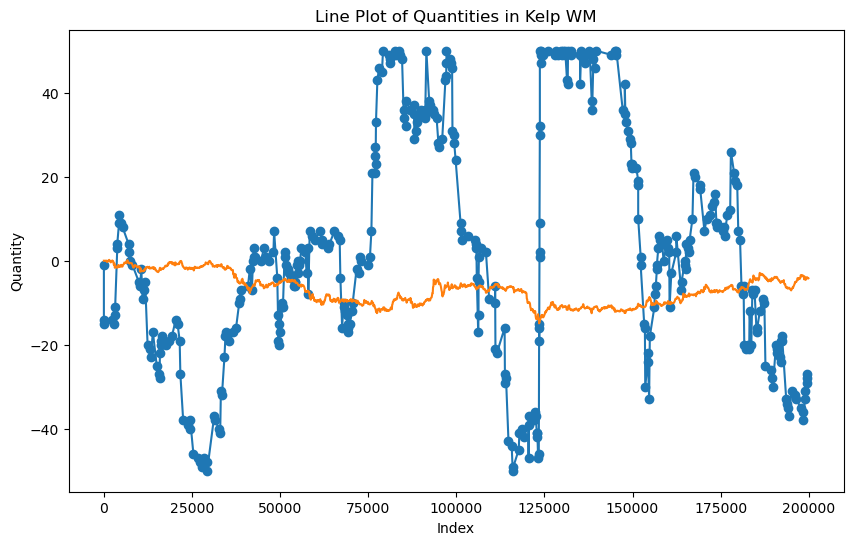

In [52]:
import json
import matplotlib.pyplot as plt

filename = "Log_kelp_wm_ga.log"
json_str = ""
found = False

with open(filename, "r") as f:
    # Read lines until we find the marker "Trade History:"
    for line in f:
        if "Trade History:" in line:
            # If the same line contains the opening bracket, use it
            if "[" in line:
                json_str = line[line.find("["):]
            else:
                # Otherwise, assume the next line starts the JSON array
                json_str = next(f)
            found = True
            break

    if not found:
        raise ValueError("Could not find 'Trade History:' with '[' in file.")

    # Append the remainder of the file to the JSON string
    json_str += f.read()

# Parse the JSON string into a list of trade objects
data = json.loads(json_str)

# Calculate the total quantity and total money paid for buyer "SUBMISSION"
quantities = []
time_lst = []
quantity = 0
for item in data:
    if item.get("buyer") == "SUBMISSION":
        quantity += item.get("quantity", 0)
        quantities.append(quantity)
        timestamp = item.get("timestamp", 0)
        time_lst.append(timestamp)
    elif item.get("seller") == "SUBMISSION":
        quantity -= item.get("quantity", 0)
        quantities.append(quantity)
        timestamp = item.get("timestamp", 0)
        time_lst.append(timestamp)

# Plot the quantities as a line plot
plt.figure(figsize=(10, 6))
plt.plot(time_lst, quantities, marker='o', linestyle='-')
plt.plot(df_kelp['timestamp'], df_kelp['profit_and_loss'])
plt.xlabel("Index")
plt.ylabel("Quantity")
plt.title("Line Plot of Quantities in Kelp WM")
plt.show()

In [15]:
from datamodel import OrderDepth, UserId, TradingState, Order

product = "KELP"
pos_limit = 50
dump_range = 30
max_profit = 1

orders = []
position = 19
sell_amount = 0

buy_quantity = 0
sell_quantity = 0

if pos_limit - dump_range <= position <= pos_limit:
    sell_amount = position
    orders.append(Order(product,round(2026) + 1,-sell_amount))
    sell_quantity += sell_amount

    print(position - sell_amount)

if -pos_limit <= position <= -pos_limit + dump_range:
    buy_amount = - position
    orders.append(Order(product,round(2026) - 1,buy_amount))
    buy_quantity += buy_amount

    print(position + buy_amount)



In [6]:
int(1.7)
round(1.4)

1